In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import scanpy as sc 
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import os, sys 
sys.path.append('../../src')
import sys
import scanpy as sc
sys.path.append('/Users/koush/Projects/SpaceOracle/src/')
import celloracle as co

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [3]:
adata = sc.read_h5ad('/Users/koush/Desktop/training_data/mouse_kidney_13.h5ad')
adata

AnnData object with n_obs × n_vars = 8509 × 3058
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    uns: 'cell_type_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
    varm: 'PCs'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [6]:
from spaceoracle.tools.network import RegulatoryFactory
co_grn = RegulatoryFactory(
    colinks_path='/Users/koush/Desktop/training_data/mouse_kidney_13_colinks.pkl',
    annot='cell_type_int'
)

In [7]:
from spaceoracle.models.parallel_estimators import *

cell_threshes = pd.read_parquet(
    '/Users/koush/Desktop/training_data/mouse_kidney_13_LRs.parquet')
adata.uns['cell_thresholds'] = cell_threshes
adata.uns['cell_thresholds'].shape

(8509, 196)

In [23]:
from spaceoracle.models.parallel_estimators import SpatialCellularProgramsEstimator

estimator = SpatialCellularProgramsEstimator(
    adata=adata,
    target_gene='Cd74',
    layer='imputed_count',
    cluster_annot='cell_type_int', 
    grn=co_grn,
    radius=100
)

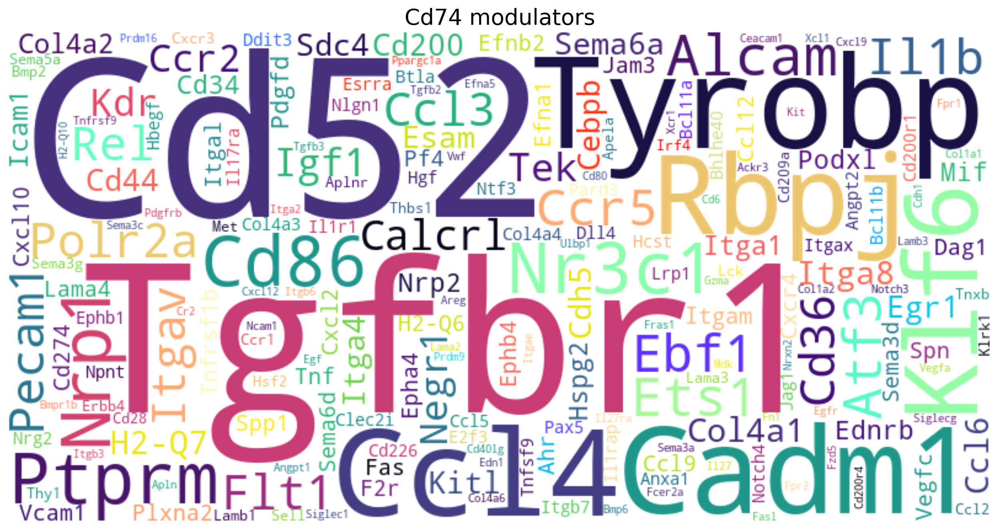

In [24]:
estimator.plot_modulators()

In [25]:
len(estimator.lr_pairs)

325

In [26]:
estimator.fit(num_epochs=50, learning_rate=5e-3, score_threshold=0.1)

Fitting Cd74 with 407 modulators
	25 Transcription Factors
	325 Ligand-Receptor Pairs
	57 TranscriptionFactor-Ligand Pairs
0: 0.9954 | 0.9953
1: 0.9026 | 0.8953
2: 0.9517 | 0.9376
3: 0.9297 | 0.9073
4: 0.9597 | 0.9576
5: 0.4220 | 0.3770
6: 0.9014 | 0.9174


In [27]:
betadata = estimator.betadata

In [31]:
betadata.mean().sort_values()

beta_Ebf1            -0.894807
beta_Bcl11b          -0.822811
beta_Cebpb           -0.804276
beta_Nr3c1           -0.733461
beta_E2f3            -0.725908
                        ...   
beta_Lck$Cd8a         0.217076
beta_Col9a3$Sdc4      0.275100
beta_Sema5a$Plxnb3    0.289625
beta_Irf4             0.587931
beta0                 4.266498
Length: 408, dtype: float32

In [27]:
estimator.betadata.to_parquet(f'./models/{estimator.target_gene}_betadata.parquet')

In [28]:
from spaceoracle.prophets import Prophet

In [29]:
pythia = Prophet(
    adata=estimator.adata,
    models_dir='./models',
    annot='cell_type_int',
    annot_labels='cell_type'
)

In [30]:
gex_df = estimator.adata.to_df(layer=estimator.layer)
pythia.compute_betas()
beta_dict = pythia._get_wbetas_dict(pythia.beta_dict, pythia.adata.layers['imputed_count'])
wbetas = beta_dict.data[estimator.target_gene].wbetas
xy = beta_dict.xydf.copy()
xy.columns = ['x', 'y']
df = wbetas \
        .join(estimator.adata.obs) \
        .join(xy) \
        .join(gex_df)

Interactions: 100%|██████████| 2/2 [00:00<00:00, 23.82it/s]


In [31]:
import anndata as ad
import pandas as pd

In [32]:
df['cell_type'].unique()

[2, 0, 5, 6, 3, 1, 4]
Categories (7, int8): [0, 1, 2, 3, 4, 5, 6]

In [48]:
estimator.receptors

['Tgfbr1',
 'Tgfbr1',
 'Bmpr1b',
 'Bmpr1b',
 'Fzd5',
 'Fzd5',
 'Egfr',
 'Egfr',
 'Egfr',
 'Erbb4',
 'Egfr',
 'Erbb4',
 'Erbb4',
 'Erbb4',
 'Erbb4',
 'Itgav',
 'Itgb3',
 'Pdgfra',
 'Pdgfrb',
 'Flt1',
 'Kdr',
 'Kdr',
 'Itgav',
 'Itgb3',
 'Aplnr',
 'Ccr1',
 'Ccr1',
 'Ccr1',
 'Ccr1',
 'Ccr2',
 'Ccr2',
 'Ccr2',
 'Ccr2',
 'Ccr5',
 'Ccr5',
 'Ccr5',
 'Cxcr2',
 'Cxcr2',
 'Cxcr3',
 'Cxcr3',
 'Cxcr3',
 'Cxcr4',
 'Ackr3',
 'Cd74',
 'Cxcr4',
 'Cd44',
 'Cxcr2',
 'Ackr3',
 'Xcr1',
 'Il27ra',
 'Il1r1',
 'Il1rap',
 'Il17ra',
 'Tnfrsf1b',
 'Fas',
 'Tnfrsf9',
 'Itgb3',
 'Itgam',
 'Cd44',
 'Itgav',
 'Itgb3',
 'Itgb6',
 'Itga4',
 'Itga8',
 'Tek',
 'Tek',
 'Sdc1',
 'Sdc4',
 'Itga4',
 'Lrp1',
 'Sdc1',
 'Sdc4',
 'Itgav',
 'Itgb3',
 'Cr2',
 'Itgam',
 'Itgax',
 'Ednrb',
 'F2r',
 'Pard3',
 'Kit',
 'Met',
 'Ntrk3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp1',
 'Plxna2',
 'Plxna3',
 'Nrp2',
 'Nrp2',
 'Nrp2',
 'Plxna2',
 'Plxna3',
 'Fpr2',
 'Fpr1',
 'Aplnr',
 'Calcrl',
 'Gucy2c',
 'Tnfrsf1

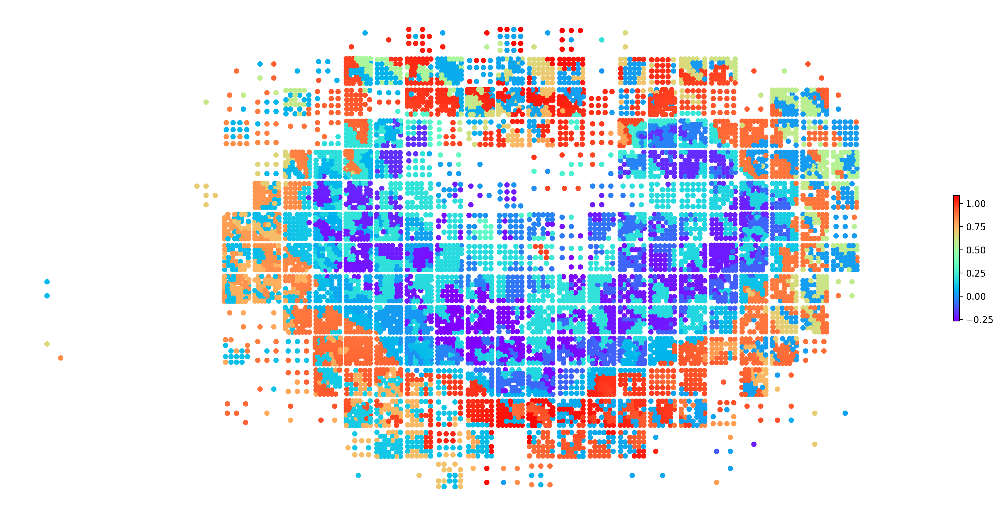

: 

In [50]:
plt.rcParams['figure.figsize'] = (22, 10)
plt.rcParams['figure.dpi'] = 100

fig, ax = plt.subplots()
scatter = ax.scatter(
    df['x'], df['y'],
    c=df['beta_Egfr'],
    s=35, marker='o',
    cmap='rainbow', linewidth=0.0, edgecolor='black'
)
ax.set_axis_off()

# Add colorbar
cbar = plt.colorbar(scatter, shrink=0.25)
# cbar.set_label('beta_Egfr')

plt.show()

In [44]:
betas = df[[i for i in df.columns if 'beta' in i]].mean().sort_values()
selected_betas = pd.concat([betas.head(8), betas.tail(7)])

fig = plt.figure(figsize=(20, 18), dpi=200)

# Get global min/max for consistent colorbar scale
vmin = df[selected_betas.index].min().min()
vmax = df[selected_betas.index].max().max()
norm = plt.Normalize(vmin=vmin, vmax=vmax)

# Create subplot grid with space at bottom for colorbar
gs = plt.GridSpec(4, 5, height_ratios=[1, 1, 1, 0.1])

for idx, b in enumerate(selected_betas.index):
    ax = plt.subplot(gs[idx//5, idx%5])
    
    scatter = sns.scatterplot(
        data=df, 
        x='y', y='x', 
        hue=b,
        size=1,
        alpha=1,
        edgecolor='black',
        linewidth=0.0,
        palette='rainbow',
        ax=ax)
    
    ax.set_title(b)
    ax.get_legend().remove()
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False) 
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

# Add single colorbar at bottom
cbar_ax = plt.subplot(gs[3, :])
plt.colorbar(
    plt.cm.ScalarMappable(norm=norm, cmap='rainbow'),
    cax=cbar_ax,
    orientation='horizontal',
    label='Beta Value',
    shrink=0.5
)

plt.tight_layout()
plt.show()

In [1]:
import matplotlib

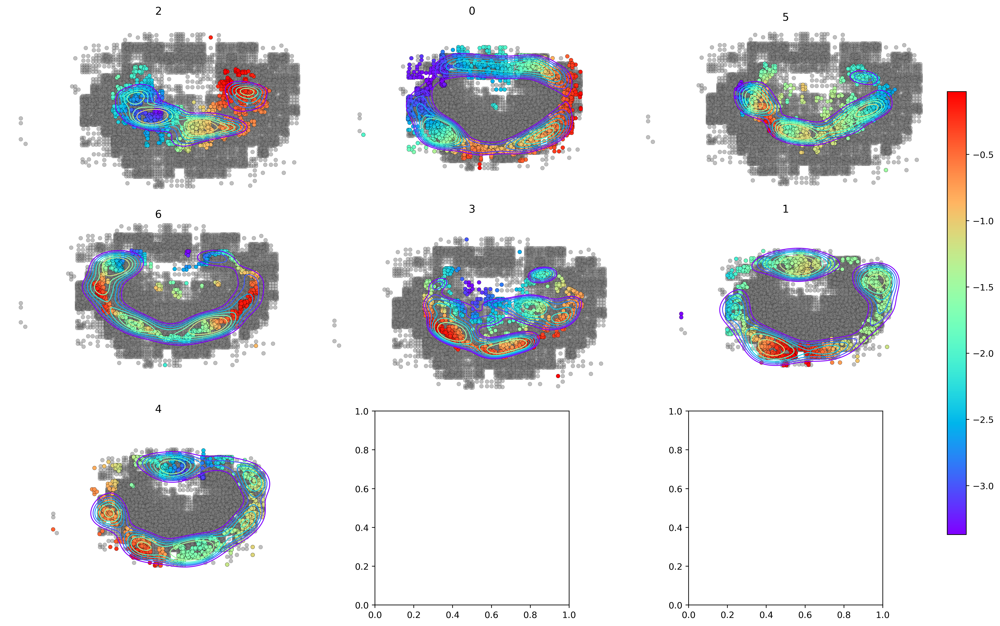

In [49]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

plt.rcParams['figure.figsize'] = (9, 9)
plt.rcParams['figure.dpi'] = 140

modulator = 'E2f3'
cell_types = df['cell_type'].unique()

n_cells = len(cell_types)

# Create a grid of subplots
n_cols = 3
s = 20
n_rows = (n_cells + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 10), dpi=200)
axes = axes.flatten()


# Create a single colorbar that will be used for all plots
norm = plt.Normalize(df[f'beta_{modulator}'].min(), df[f'beta_{modulator}'].max())
sm = plt.cm.ScalarMappable(cmap='rainbow', norm=norm)

for i, cell_type in enumerate(cell_types):
    # Plot other cells in grey
    sns.scatterplot(
        data=df[df['cell_type'] != cell_type],
        x='x',
        y='y',
        color='grey',
        s=s,
        linewidth=0.2,
        alpha=0.5,
        edgecolor='black',
        legend=False,
        ax=axes[i]
    )

    # Plot target cell type colored by modulator
    scatter = sns.scatterplot(
        data=df[df['cell_type'] == cell_type],
        x='x',
        y='y',
        hue=f'beta_{modulator}',
        palette='rainbow',
        s=s,
        linewidth=0.2,
        edgecolor='black',
        legend=False,
        ax=axes[i]
    )

    # Add contour plot
    cell_type_data = df[df['cell_type'] == cell_type]
    sns.kdeplot(
        data=cell_type_data,
        x='x',
        y='y',
        levels=7,
        linewidths=1,
        alpha=1,
        cmap='rainbow',
        fill=False,
        ax=axes[i],
        thresh=0.4  # Add threshold to remove the lowest contour
    )
    axes[i].set_title(cell_type)
    axes[i].set_axis_off()
    
    # Set equal aspect ratio to prevent distortion
    axes[i].set_aspect('equal')

# # Remove empty subplots if any
# for j in range(i+1, len(axes)):
#     fig.delaxes(axes[j])

# Add a single colorbar to the right of the entire figure
cbar_ax = fig.add_axes([1, 0.15, 0.02, 0.7])
plt.colorbar(sm, cax=cbar_ax, orientation='vertical', shrink=1)

for ax in axes:
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()